In [ ]:
from pathlib import Path
from io import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, HTML
import html  # for safe HTML escaping
from concurrent.futures import ThreadPoolExecutor, as_completed
import mimetypes, os, time
from google import genai
from google.genai import types

from dotenv import load_dotenv

load_dotenv()  # reads .env in the cwd or project root

client = genai.Client(api_key=os.getenv("GEMINI_API_KEY"))

In [6]:


# assumes:


IMAGES_DIR  = Path("images")
PROMPTS_DIR = Path("prompts")
OUTPUTS_DIR = Path("outputs"); OUTPUTS_DIR.mkdir(parents=True, exist_ok=True)

EXTS = {".png", ".jpg", ".jpeg", ".webp", ".bmp", ".tif", ".tiff"}
VARIANTS_PER_IMAGE = 4

def guess_mime(p: Path) -> str:
    mt, _ = mimetypes.guess_type(p.as_posix())
    return mt or "image/png"

TEMPLATE = """TASK
You are an image editor. First, if provided, apply the GLOBAL DIRECTIVE to the whole image. Then read every instruction box, perform those edits, and finally remove all boxes.

GLOBAL DIRECTIVE (optional, scene-wide)
• VALUE: "{GLOBAL_DIRECTIVE}"

WHAT COUNTS AS A BOX
• A dark/black semi-transparent rectangle with white text.
• Use the box center as the anchor; affect the box area (expand up to ~3× if needed).

ALLOWED ACTIONS (case-insensitive)
• ADD / REMOVE / REPLACE A WITH B / SWAP TO <style>.

EDITING RULES
• Preserve composition; only change what is requested.
• Match lighting, shadows, reflections, textures, perspective, DOF.
• Respect occlusions; cast plausible shadows.
• Local box instructions override the global directive in their region.
• Apply boxes in order: REMOVE → REPLACE → ADD → SWAP.
• Remove all boxes at the end (no outlines, no text).

VARIATION HINT
• Produce a distinct but valid variant #{VAR} by varying only non-essential attributes (crop/viewpoint, subtle grade/DOF, micro-lighting), never adding/removing beyond the requested edits.

OUTPUT
• Return the edited IMAGE only — no overlays, no captions, no borders, no boxes.
"""

def build_prompt(global_str: str, variant_idx: int) -> str:
    return (TEMPLATE
            .replace("{GLOBAL_DIRECTIVE}", global_str if global_str.strip() else "NONE")
            .replace("{VAR}", str(variant_idx)))

def load_global_directive(stem: str) -> str:
    txt = PROMPTS_DIR / f"{stem}.txt"
    if txt.exists():
        s = txt.read_text(encoding="utf-8").strip()
        return s if s else "NONE"
    return "NONE"

def generate_variant(img_path: Path, global_directive: str, variant_idx: int, out_dir: Path) -> Path:
    image_bytes = img_path.read_bytes()
    part = types.Part.from_bytes(data=image_bytes, mime_type=guess_mime(img_path))
    final_prompt = build_prompt(global_directive, variant_idx)

    resp = client.models.generate_content(
        model="gemini-2.5-flash-image-preview",
        contents=[final_prompt, part],  # prompt first, then image
        config=types.GenerateContentConfig(
            response_modalities=["IMAGE"],  # image-only; faster
            temperature=0.4,                # allow subtle diversity
        ),
    )

    # extract first image from the response
    image_bytes_out = None
    for cand in getattr(resp, "candidates", []) or []:
        parts = getattr(getattr(cand, "content", None), "parts", []) or []
        for p in parts:
            if getattr(p, "inline_data", None):
                image_bytes_out = p.inline_data.data
                break
        if image_bytes_out:
            break

    if not image_bytes_out:
        raise RuntimeError("No image bytes returned (possibly safety or decoding).")

    out_path = out_dir / f"{img_path.stem}_v{variant_idx}{img_path.suffix}"
    Image.open(BytesIO(image_bytes_out)).save(out_path)
    return out_path

# ---- Iterate through all images sequentially; 4 workers per image ----
all_images = [p for p in sorted(IMAGES_DIR.iterdir())
              if p.is_file() and p.suffix.lower() in EXTS]

if not all_images:
    print("No images found.")
else:
    print(f"Found {len(all_images)} image(s). Processing sequentially…\n")

for img_path in all_images:
    # if str(img_path) != "images/5.png":
    #     print(img_path)
    #     continue

    stem = img_path.stem
    gd = load_global_directive(stem)
    print(f"Starting {img_path.name} (global='{gd}') …")

    t0 = time.perf_counter()
    variants = []


    # Start 4 workers for this ONE image; wait for them to finish before next image
    with ThreadPoolExecutor(max_workers=VARIANTS_PER_IMAGE) as ex:
        futures = [ex.submit(generate_variant, img_path, gd, i+1, OUTPUTS_DIR)
                   for i in range(VARIANTS_PER_IMAGE)]
        for fut in as_completed(futures):
            try:
                out_path = fut.result()
                variants.append(out_path)
                print(f"  saved → {out_path.name}")
            except Exception as e:
                print(f"  [ERROR] {img_path.name}: {e}")

    elapsed = time.perf_counter() - t0
    print(f"Completed {img_path.name}: {len(variants)}/{VARIANTS_PER_IMAGE} variant(s) in {elapsed:.2f}s\n")

print("All done.")


Found 7 image(s). Processing sequentially…

Starting 1.png (global='Make the time of day midnight') …


KeyboardInterrupt: 

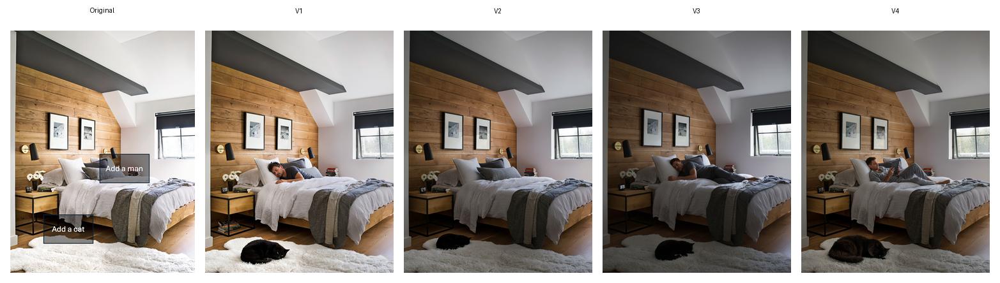

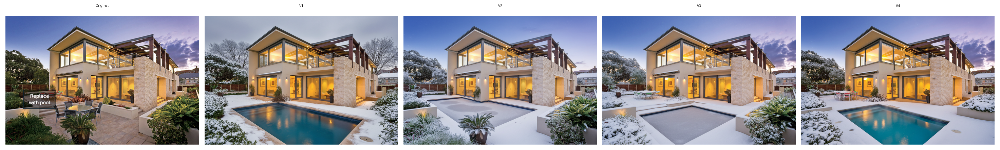

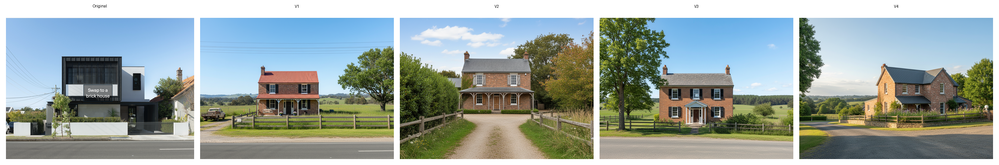

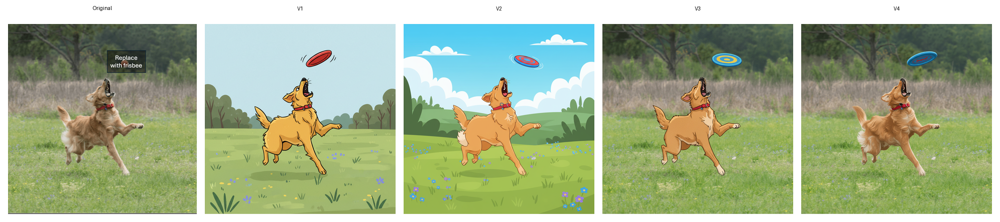

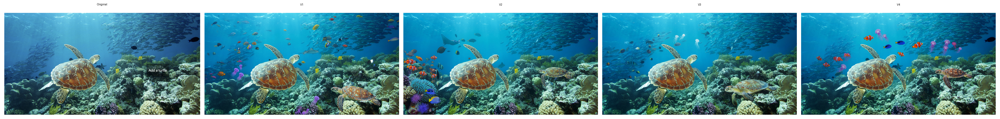

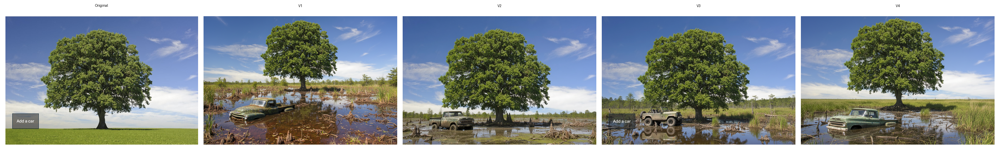

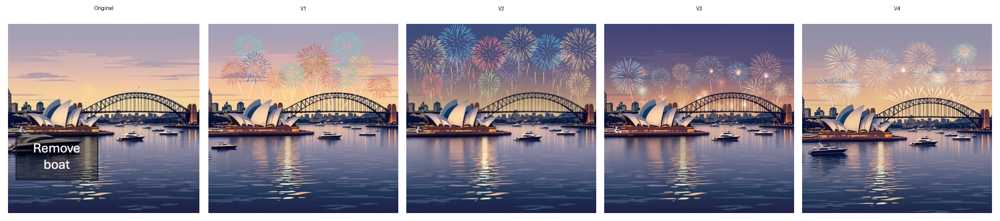

In [2]:
from pathlib import Path
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, HTML
import html

images_dir  = Path("images")
outputs_dir = Path("outputs")
prompts_dir = Path("prompts")

exts = {".png", ".jpg", ".jpeg", ".webp", ".bmp", ".tif", ".tiff"}

# originals
before_files = {
    p.name: p for p in images_dir.iterdir()
    if p.is_file() and p.suffix.lower() in exts
}

def load_global_directive(stem: str) -> str:
    txt_path = prompts_dir / f"{stem}.txt"
    try:
        if txt_path.exists():
            s = txt_path.read_text(encoding="utf-8").strip()
            return s if s else "NONE"
    except Exception as e:
        return f"[error reading {txt_path.name}: {e}]"
    return "NONE"

def row_gallery(images, labels, pad=16, label_h=32, target_h=380, bg=(255,255,255)) -> Image.Image:
    """
    Create a single-row gallery with labels above each image.
    All images are scaled to target_h (keeping aspect).
    """
    if not images:
        raise ValueError("No images to display")

    # load + convert + scale
    tiles = []
    for im in images:
        im = im.convert("RGB")
        if target_h and im.height != target_h:
            new_w = int(im.width * (target_h / im.height))
            im = im.resize((new_w, target_h), Image.LANCZOS)
        tiles.append(im)

    # canvas size
    total_w = sum(im.width for im in tiles) + pad * (len(tiles) + 1)
    total_h = label_h + pad + target_h + pad
    canvas = Image.new("RGB", (total_w, total_h), bg)
    draw = ImageDraw.Draw(canvas)
    font = ImageFont.load_default()

    # paste tiles + labels
    x = pad
    for im, label in zip(tiles, labels):
        # center label above tile
        tw, th = draw.textbbox((0,0), label, font=font)[2:]
        tx = x + (im.width - tw) // 2
        ty = (label_h - th) // 2
        draw.text((tx, ty), label, fill=(0,0,0), font=font)

        # paste image
        canvas.paste(im, (x, label_h + pad))
        x += im.width + pad

    return canvas

# ----- Display originals with up to four variants -----
names = sorted(before_files.keys())
if not names:
    display(HTML("<b>No originals found in images/.</b>"))
else:
    display(HTML(f"<b>Showing {len(names)} original(s) with variants (when present):</b>"))

for name in names:
    stem = Path(name).stem
    suffix = Path(name).suffix

    # gather variants _v1.._v4 if they exist
    variants = []
    labels   = ["Original"]
    try:
        before_img = Image.open(before_files[name])
    except Exception as e:
        display(HTML(f"<div style='color:#b00'>Error opening original {html.escape(name)}: {html.escape(str(e))}</div>"))
        continue

    images = [before_img]

    for i in range(1, 5):
        vpath = outputs_dir / f"{stem}_v{i}{suffix}"
        if vpath.exists():
            try:
                images.append(Image.open(vpath))
                labels.append(f"V{i}")
            except Exception as e:
                display(HTML(f"<div style='color:#b00'>Error opening variant {html.escape(vpath.name)}: {html.escape(str(e))}</div>"))

    # If no numbered variants, fall back to a single plain output with same name (optional)
    if len(images) == 1:
        plain = outputs_dir / name
        if plain.exists():
            try:
                images.append(Image.open(plain))
                labels.append("Edited")
            except Exception as e:
                display(HTML(f"<div style='color:#b00'>Error opening edited {html.escape(plain.name)}: {html.escape(str(e))}</div>"))

    # header + directive
    gd = load_global_directive(stem)
    gd_display = "(none)" if gd == "NONE" else html.escape(gd)

    display(HTML(
        f"""
        <div style="margin:12px 0 6px 0">
          <h4 style="margin:0">{html.escape(name)}</h4>
          <div style="font-size:13px;color:#444">
            Global directive: <code>{gd_display}</code>
          </div>
        </div>
        """
    ))

    try:
        gallery = row_gallery(images, labels, target_h=380)  # adjust height as you like
        display(gallery)
    except Exception as e:
        display(HTML(f"<div style='color:#b00'>Error composing gallery for {html.escape(name)}: {html.escape(str(e))}</div>"))

